In [ ]:
#!/usr/bin/env python3
"""
MRI File Processor and Visualizer

This script provides functions to:
- Import MRI files from a folder (.nii, .nii.gz, .dcm)
- Convert files and their metadata to a pandas DataFrame
- Display the MRI images in a 3-column grid layout

Requirements:
- nibabel (for NIfTI files)
- pydicom (for DICOM files)
- pandas, numpy, matplotlib

Installation:
    pip install nibabel pydicom pandas numpy matplotlib

Usage example:
    df = process_and_display_mri_folder('/path/to/mri/folder')
"""

import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')

def import_mri_files_to_dataframe(folder_path, max_images=None):
    """
    Import all MRI files from a folder and convert to a dataframe.

    Parameters:
    -----------
    folder_path : str
        Path to the folder containing MRI files
    max_images : int, optional
        Maximum number of images to process (None for all)

    Returns:
    --------
    pd.DataFrame
        DataFrame containing file information and image data
    """
    mri_extensions = ['.nii', '.nii.gz', '.dcm', '.img', '.hdr']
    folder = Path(folder_path)
    if not folder.exists():
        raise ValueError(f"Folder {folder_path} does not exist")

    mri_files = []
    for ext in mri_extensions:
      mri_files.extend(list(folder.glob(f'*{ext}')))  # shallow search in folder
      mri_files.extend(list(folder.rglob(f'*{ext}')))  # recursive search in all subfolders


    if not mri_files:
        raise ValueError(f"No MRI files found in {folder_path}")

    if max_images:
        mri_files = mri_files[:max_images]

    print(f"Found {len(mri_files)} MRI files")

    file_data = []
    for file_path in mri_files:
        file_info = {
            'filename': file_path.name,
            'filepath': str(file_path),
            'extension': file_path.suffix,
            'size_mb': file_path.stat().st_size / (1024 * 1024),
        }

        try:
            if file_path.suffix in ['.nii', '.nii.gz']:
                # Load NIfTI files
                try:
                    import nibabel as nib
                    img = nib.load(str(file_path))
                    data = img.get_fdata()
                    file_info.update({
                        'shape': data.shape,
                        'data_type': str(data.dtype),
                        'min_value': float(np.min(data)),
                        'max_value': float(np.max(data)),
                        'mean_value': float(np.mean(data)),
                        'image_data': data
                    })
                except ImportError:
                    file_info.update({
                        'error': 'nibabel not installed - run pip install nibabel',
                        'image_data': None
                    })

            elif file_path.suffix == '.dcm':
                # Load DICOM files
                try:
                    import pydicom
                    dcm = pydicom.dcmread(str(file_path))
                    data = dcm.pixel_array
                    file_info.update({
                        'shape': data.shape,
                        'data_type': str(data.dtype),
                        'min_value': float(np.min(data)),
                        'max_value': float(np.max(data)),
                        'mean_value': float(np.mean(data)),
                        'image_data': data,
                        'patient_id': getattr(dcm, 'PatientID', 'Unknown'),
                        'study_date': getattr(dcm, 'StudyDate', 'Unknown')
                    })
                except ImportError:
                    file_info.update({
                        'error': 'pydicom not installed - run pip install pydicom',
                        'image_data': None
                    })

            else:
                file_info.update({
                    'error': f'Unsupported file format: {file_path.suffix}',
                    'image_data': None
                })

        except Exception as e:
            file_info.update({
                'error': f'Error loading file: {str(e)}',
                'image_data': None
            })

        file_data.append(file_info)

    df = pd.DataFrame(file_data)
    print(f"Created DataFrame with {len(df)} entries")
    return df


def display_mri_images_3_per_row(df, slice_index='middle', figsize=(15, 5), cmap='gray'):
    """
    Display MRI images from dataframe in a 3-column grid.

    Parameters:
    -----------
    df : pd.DataFrame
        DataFrame containing MRI data with 'image_data' column
    slice_index : str or int
        Which slice to display ('middle', 'first', 'last', or specific index)
    figsize : tuple
        Figure size per row (width, height)
    cmap : str
        Colormap for displaying images
    """

    valid_images = df[df['image_data'].notna()].copy()
    if valid_images.empty:
        print("No valid image data found in DataFrame")
        return

    print(f"Displaying {len(valid_images)} MRI images")

    n_images = len(valid_images)
    n_rows = (n_images + 2) // 3  # ceiling division for rows

    fig, axes = plt.subplots(n_rows, 3, figsize=(figsize[0], figsize[1]*n_rows))
    if n_rows == 1:
        axes = axes.reshape(1, -1)
    axes_flat = axes.flatten()

    for idx, (_, row) in enumerate(valid_images.iterrows()):
        if idx >= len(axes_flat):
            break
        ax = axes_flat[idx]
        image_data = row['image_data']

        try:
            if image_data is None:
                ax.text(0.5, 0.5, "No Image Data", ha='center', va='center', transform=ax.transAxes)
                ax.axis('off')
                continue

            if len(image_data.shape) == 3:
                if slice_index == 'middle':
                    slice_idx = image_data.shape[2] // 2
                elif slice_index == 'first':
                    slice_idx = 0
                elif slice_index == 'last':
                    slice_idx = image_data.shape[2] - 1
                else:
                    slice_idx = min(int(slice_index), image_data.shape[2] - 1)
                display_slice = image_data[:, :, slice_idx]

            elif len(image_data.shape) == 4:
                vol_idx = image_data.shape[3] // 2
                slice_idx = image_data.shape[2] // 2
                display_slice = image_data[:, :, slice_idx, vol_idx]

            elif len(image_data.shape) == 2:
                display_slice = image_data

            else:
                ax.text(0.5, 0.5, f"Unsupported shape: {image_data.shape}", ha='center', va='center', transform=ax.transAxes)
                ax.axis('off')
                continue

            im = ax.imshow(display_slice, cmap=cmap, aspect='equal')
            ax.set_title(f"{row['filename']}\n{display_slice.shape}", fontsize=10)
            ax.axis('off')
            plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

        except Exception as e:
            ax.text(0.5, 0.5, f"Error displaying:\n{str(e)}", ha='center', va='center', transform=ax.transAxes)
            ax.set_title(f"{row['filename']} (Error)", fontsize=10)
            ax.axis('off')

    for i in range(n_images, len(axes_flat)):
        axes_flat[i].axis('off')

    plt.tight_layout()
    plt.show()


def process_and_display_mri_folder(folder_path, max_images=None, slice_index='middle',
                                 figsize=(15, 5), cmap='gray', save_df=False, output_csv=None):
    """
    Complete workflow to import MRI files from folder, convert to DataFrame, and display images.

    Parameters:
    -----------
    folder_path : str
        Path to the folder containing MRI files
    max_images : int, optional
        Maximum images to process
    slice_index : str or int
        Slice to display ('middle', 'first', 'last', or index)
    figsize : tuple
        Size of figure per row
    cmap : str
        Colormap to use
    save_df : bool
        Save DataFrame to CSV (excluding image data)
    output_csv : str
        Name of CSV file to save

    Returns:
    --------
    pd.DataFrame or None
        DataFrame with MRI files information and image data; None on failure
    """

    print("="*60)
    print("MRI FILE PROCESSOR AND VISUALIZER")
    print("="*60)

    try:
        print("\nStep 1: Importing MRI files...")
        df = import_mri_files_to_dataframe(folder_path, max_images)

        # Remove duplicates based on image data
        print("\nStep 2: Removing duplicate images...")
        initial_count = len(df)
        df['image_data_hash'] = df['image_data'].apply(lambda x: hash(x.tobytes()) if x is not None else None)
        df = df.drop_duplicates(subset=['image_data_hash']).drop(columns=['image_data_hash'])
        duplicates_removed = initial_count - len(df)
        print(f"Removed {duplicates_removed} duplicate images.")


        print("\nStep 3: Renaming files sequentially...")
        # Add a new column with sequential filenames
        df['new_filename'] = [f"DTI_gated_{i+1:02d}{Path(row['filepath']).suffix}" for i, row in df.iterrows()]
        print("Files renamed.")


        #print("\nStep 4: DataFrame Summary:")
        #print(f"Total files processed: {len(df)}")
        #print(f"Successful loads: {len(df[df['image_data'].notna()])}")
        #print(f"Failed loads: {len(df[df['image_data'].isna()])}")

        if len(df[df['image_data'].notna()]) > 0:
            valid_df = df[df['image_data'].notna()]
            print("\nImage Statistics:")
            print(f"Average file size: {valid_df['size_mb'].mean():.2f} MB")
            if 'min_value' in valid_df.columns and 'max_value' in valid_df.columns:
                print(f"Intensity range: {valid_df['min_value'].min():.1f} to {valid_df['max_value'].max():.1f}")

        print("\nStep 5: Displaying MRI images (3 per row)...")
        display_mri_images_3_per_row(df, slice_index, figsize, cmap)

        if save_df:
            if output_csv is None:
                output_csv = 'dataframe.csv'
            df_for_csv = df.drop('image_data', axis=1, errors='ignore')
            df_for_csv.to_csv(output_csv, index=False)
            print(f"\nDataFrame saved to: {output_csv}")

        print("\nProcessing completed successfully!")
        return df

    except Exception as e:
        print(f"\nError during processing: {str(e)}")
        return None


if __name__ == "__main__":
    # Example usage
    example_folder = "/content/Content_data"  # <== Change to your folder
    df = process_and_display_mri_folder(example_folder,
                                   max_images=65,
                                   slice_index='middle',
                                   figsize=(15, 5),
                                   cmap='gray',
                                   save_df=True, # Changed to True to save the updated dataframe
                                   )#output_csv='mri_processed_data.csv') # Added output filename

MRI FILE PROCESSOR AND VISUALIZER

Step 1: Importing MRI files...
Found 65 MRI files
Created DataFrame with 65 entries

Step 2: Removing duplicate images...
Removed 64 duplicate images.

Step 3: Renaming files sequentially...
Files renamed.

Step 5: Displaying MRI images (3 per row)...
No valid image data found in DataFrame

DataFrame saved to: dataframe.csv

Processing completed successfully!


MRI FILE PROCESSOR AND VISUALIZER

Step 1: Importing MRI files...
Found 9 MRI files
Created DataFrame with 9 entries

Step 2: Removing duplicate images...
Removed 0 duplicate images.

Step 3: Renaming files sequentially...
Files renamed.

Image Statistics:
Average file size: 2.18 MB
Intensity range: 0.0 to 1023.0

Step 5: Displaying MRI images (3 per row)...
Displaying 9 MRI images


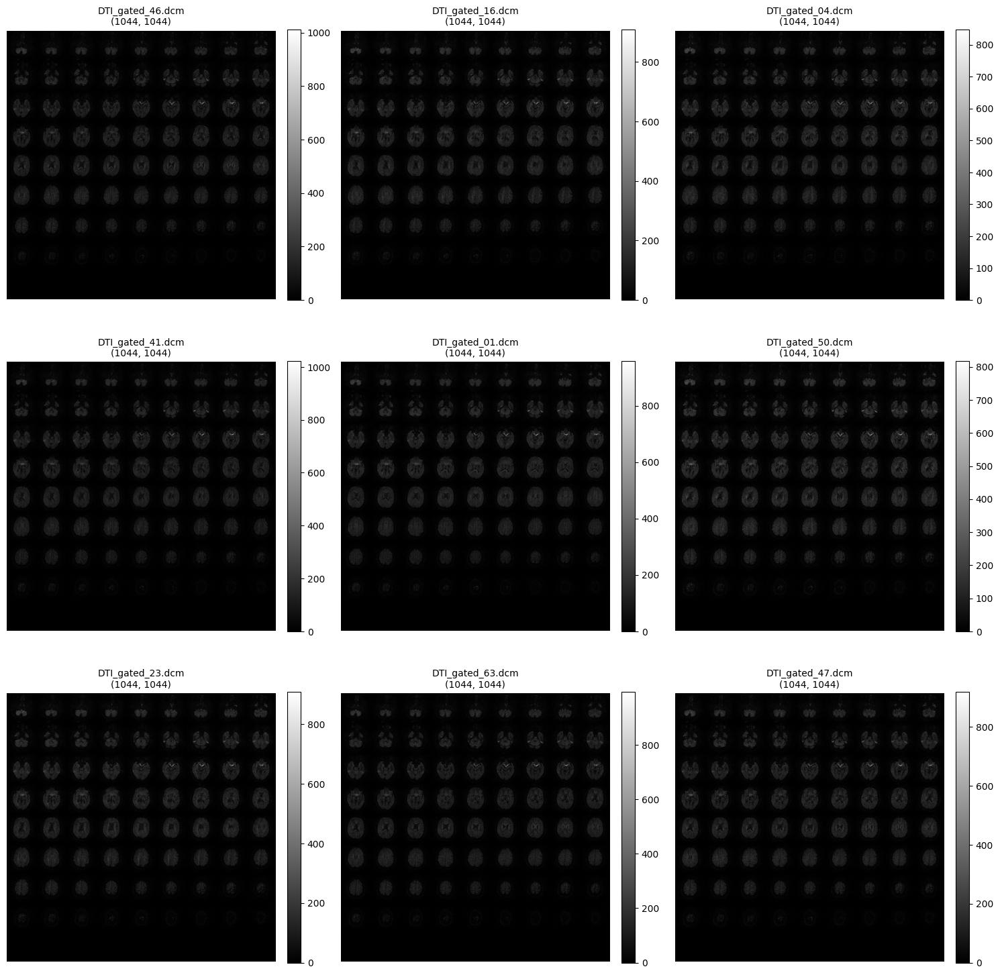


Processing completed successfully!
Displaying 9 MRI images


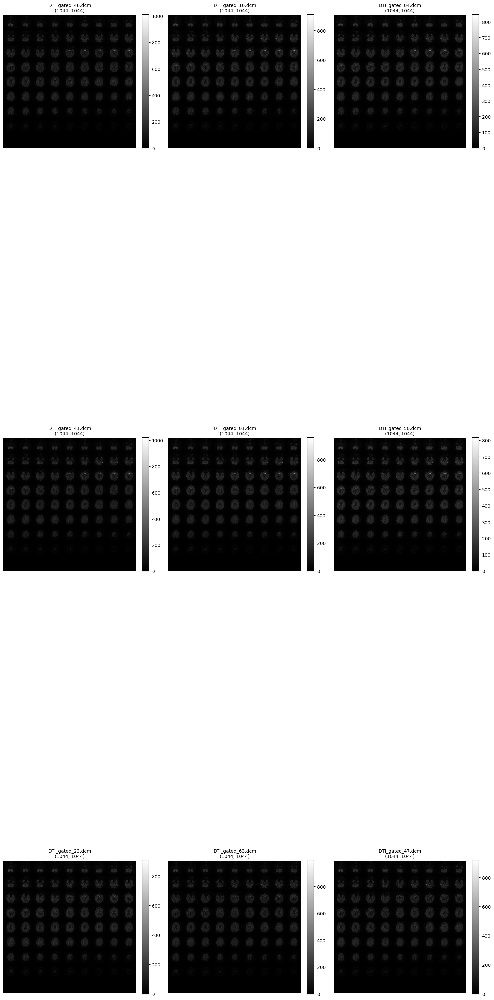

In [ ]:
# Example usage of the functions defined above
example_folder = "/content/Content_data"  # <== Change to your folder

# Process the MRI files and get the DataFrame
df = process_and_display_mri_folder(example_folder, max_images=9, save_df=False) # Adjusted max_images for 3x3 grid and set save_df to False

# Display the images in a 3x3 grid (using the existing function which defaults to 3 per row)
if df is not None:
    display_mri_images_3_per_row(df, slice_index='middle', figsize=(15, 15), cmap='gray') # Adjusted figsize for a 3x3 layout

In [ ]:
def display_single_mri_image(df, index, figsize=(10, 10), cmap='gray', slice_index='middle'):
    """
    Display a single MRI image from dataframe at a specific index.

    Parameters:
    -----------
    df : pd.DataFrame
        DataFrame containing MRI data with 'image_data' column
    index : int
        Index of the image to display
    figsize : tuple
        Figure size (width, height)
    cmap : str
        Colormap for displaying images
    slice_index : str or int
        Which slice to display ('middle', 'first', 'last', or specific index)
    """
    if index < 0 or index >= len(df):
        print(f"Index {index} is out of bounds for DataFrame with {len(df)} entries")
        return

    row = df.iloc[index]
    image_data = row.get('image_data')

    if image_data is None:
        print(f"No image data found for index {index}")
        return

    plt.figure(figsize=figsize)
    try:
        if len(image_data.shape) == 3:
            if slice_index == 'middle':
                slice_idx = image_data.shape[2] // 2
            elif slice_index == 'first':
                slice_idx = 0
            elif slice_index == 'last':
                slice_idx = image_data.shape[2] - 1
            else:
                slice_idx = min(int(slice_index), image_data.shape[2] - 1)
            display_slice = image_data[:, :, slice_idx]
            title = f"{row['filename']} (Slice: {slice_idx})"

        elif len(image_data.shape) == 4:
            vol_idx = image_data.shape[3] // 2
            slice_idx = image_data.shape[2] // 2
            display_slice = image_data[:, :, slice_idx, vol_idx]
            title = f"{row['filename']} (Volume: {vol_idx}, Slice: {slice_idx})"

        elif len(image_data.shape) == 2:
            display_slice = image_data
            title = row['filename']

        else:
            print(f"Unsupported shape for index {index}: {image_data.shape}")
            return

        im = plt.imshow(display_slice, cmap=cmap, aspect='equal')
        plt.title(title, fontsize=12)
        plt.axis('off')
        plt.colorbar(im, fraction=0.046, pad=0.04)
        plt.show()

    except Exception as e:
        print(f"Error displaying image at index {index}: {str(e)}")

# Example usage (assuming 'df' is available from previous steps)
# display_single_mri_image(df, 0, figsize=(10, 10)) # Display the first image
# display_single_mri_image(df, 5, figsize=(12, 12), cmap='viridis', slice_index=20) # Display the 6th image with different settings

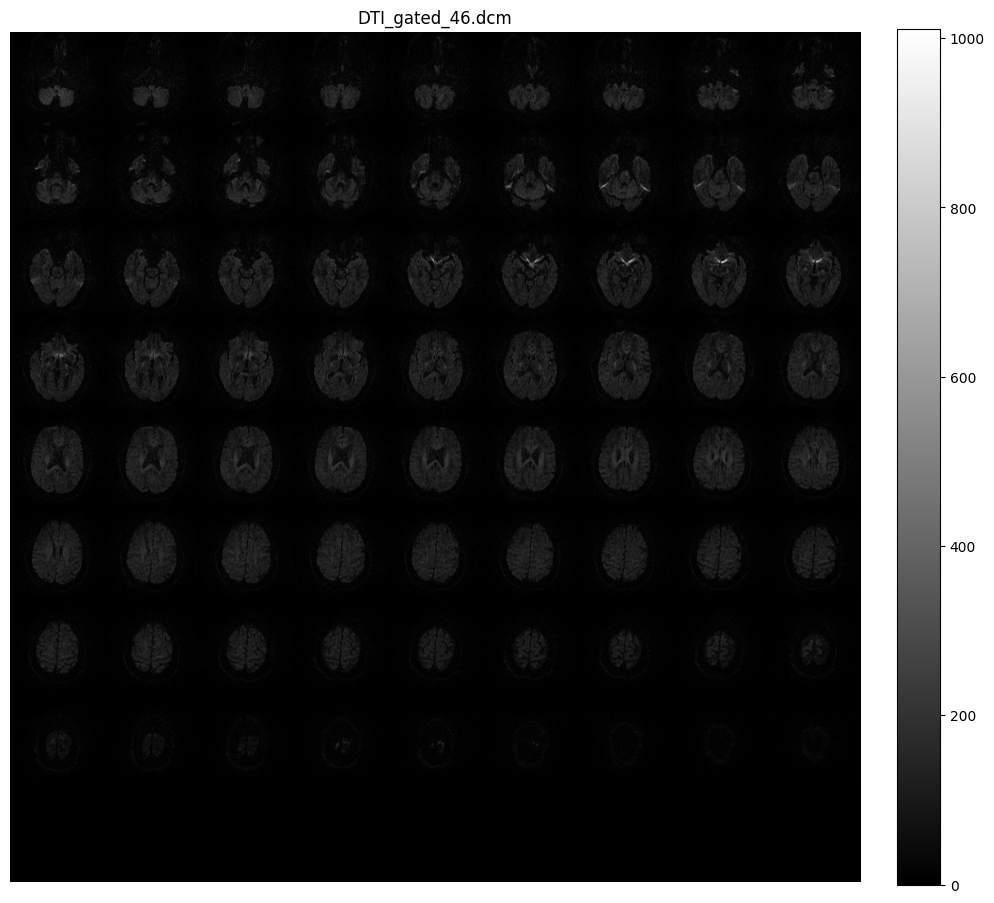

In [ ]:
# Display the first image (DTI_gated_01.dcm)
if df is not None:
    display_single_mri_image(df, 0, figsize=(12, 12), cmap='gray') # Display the image at index 0 with a larger size

In [ ]:
import numpy as np
import nibabel as nib
from scipy.ndimage import generate_binary_structure, binary_erosion, label, map_coordinates
from scipy.spatial.distance import cdist

# --- 1. MOCK DATA GENERATION (Replace this section with your real data loading) ---

def create_mock_nifti(shape=(64, 64, 64), base_value=0.3, defect_center=(30, 32, 25), defect_size=5, impact=0.1, filename="mock_map.nii.gz"):
    """
    Creates a mock NIfTI file for demonstration.
    For FA/AD/RD, impact is the change in value. For MD, it's typically an increase.
    """
    data = np.full(shape, base_value, dtype=np.float32)

    # Introduce a mock "defect" (SN pathology often results in lower FA, higher MD/RD)
    coords = np.indices(shape)
    distance = np.sqrt((coords[0] - defect_center[0])**2 +
                       (coords[1] - defect_center[1])**2 +
                       (coords[2] - defect_center[2])**2)

    # Simple Gaussian drop-off for the defect area
    defect_mask = np.exp(-(distance / defect_size)**2) * impact

    if 'fa' in filename or 'ad' in filename:
        # Pathology -> Decrease in FA/AD
        data = np.clip(data - defect_mask, 0.05, 0.95)
    elif 'md' in filename or 'rd' in filename:
        # Pathology -> Increase in MD/RD
        data = np.clip(data + defect_mask, 0.5e-3, 2.5e-3)

    # MD is scaled to be in standard units (x10^-3 mm^2/s)
    if 'md' in filename or 'rd' in filename:
         # Set a realistic base value for MD/RD (x10^-3)
        data *= 1000

    # Create NIfTI image object
    affine = np.diag([2, 2, 2, 1])
    nifti_img = nib.Nifti1Image(data, affine)
    print(f"Generated mock file: {filename}")
    return nifti_img


# Generate mock DTI maps for a single patient (using realistic base values for deep gray matter)
# MD/RD values are typically reported as x10^-3 mm^2/s
patient_fa_img = create_mock_nifti(base_value=0.35, impact=0.15, filename="patient_fa.nii.gz") # Mock FA defect (FA drops)
patient_md_img = create_mock_nifti(base_value=0.85e-3, impact=0.30e-3, filename="patient_md.nii.gz") # Mock MD defect (MD increases)
patient_ad_img = create_mock_nifti(base_value=1.10e-3, impact=0.10e-3, filename="patient_ad.nii.gz") # Mock AD (Axial) defect (AD drops)
patient_rd_img = create_mock_nifti(base_value=0.70e-3, impact=0.25e-3, filename="patient_rd.nii.gz") # Mock RD (Radial) defect (RD increases)

patient_fa_data = patient_fa_img.get_fdata()
patient_md_data = patient_md_img.get_fdata()
patient_ad_data = patient_ad_img.get_fdata()
patient_rd_data = patient_rd_img.get_fdata()

# --- 2. DEFINING SUBSTANTIA NIGRA ROI AND NORMATIVE DATA ---

# IMPORTANT: The center_coord MUST be accurately derived from your registered anatomical image.
# Using a small radius is critical for small structures like the SN.
ROIS = {
    "Substantia Nigra (Midbrain)": {
        # **REPLACE THESE COORDS** with the actual voxel coordinates of your patient's SN
        "center_coord": (30, 32, 25),
        "radius": 3, # Small radius is critical for small nuclei

        # Normative ranges for the Substantia Nigra (deep brain nuclei)
        "normative_fa": (0.30, 0.45),   # FA: Lower than WM
        "normative_md": (0.75, 0.95),   # MD (x10^-3): Higher than WM
        "normative_ad": (0.90, 1.20),   # AD (x10^-3)
        "normative_rd": (0.60, 0.85),   # RD (x10^-3)
        "key_metrics": ["FA", "MD", "AD", "RD"],
        "defect_type": "Dopaminergic Neurodegeneration (e.g., Parkinson's)"
    }
}

# --- 3. ANALYSIS FUNCTION ---

def get_roi_mask(data_shape, center, radius):
    """Generates a spherical mask (ROI) in voxel space."""
    coords = np.indices(data_shape)
    distance = np.sqrt((coords[0] - center[0])**2 +
                       (coords[1] - center[1])**2 +
                       (coords[2] - center[2])**2)
    return distance <= radius

def analyze_dti_patient(data_maps, rois):
    """Performs ROI analysis and compares metrics to normative data."""
    results = []

    print("\n--- DTI Analysis: Focused on Substantia Nigra ---")
    print("-" * 50)

    # Check if all required data is present
    if not all(k in data_maps for k in ["FA", "MD", "AD", "RD"]):
        print("ERROR: Missing one or more DTI data maps (FA, MD, AD, RD). Cannot proceed.")
        return results

    for roi_name, roi_params in rois.items():
        center = roi_params["center_coord"]
        radius = roi_params["radius"]

        # We assume all maps have the same shape
        roi_mask = get_roi_mask(data_maps["FA"].shape, center, radius)

        print(f"\nAnalyzing: {roi_name} (Center: {center}, Radius: {radius})")

        for metric in roi_params["key_metrics"]:
            map_data = data_maps.get(metric)
            normative_range = roi_params[f"normative_{metric.lower()}"]
            low_bound, high_bound = normative_range

            roi_values = map_data[roi_mask]

            # Filter out non-brain or very low quality voxels
            if roi_values.size == 0 or np.sum(roi_mask) < 5:
                print(f"  > {metric}: Insufficient data points in ROI. Check coordinates/radius.")
                continue

            patient_mean = np.mean(roi_values)
            flag = ""

            # Define ALERT conditions based on typical pathology
            if metric == "FA" and patient_mean < low_bound:
                flag = "ALERT: Decreased FA (Low FA suggests cellular loss/disorganization)"
            elif (metric == "MD" or metric == "RD") and patient_mean > high_bound:
                flag = f"ALERT: Increased {metric} (High {metric} suggests fluid/edema/tissue change)"
            elif metric == "AD" and patient_mean < low_bound:
                flag = "WARNING: Low AD (Suggests potential axonal damage, though less common in pure SN atrophy)"

            # Format MD/AD/RD for readability (x10^-3)
            if metric != "FA":
                display_mean = f"{patient_mean:.3f} x10^-3"
                display_range = f"({low_bound:.3f} - {high_bound:.3f}) x10^-3"
            else:
                display_mean = f"{patient_mean:.4f}"
                display_range = f"({low_bound:.4f} - {high_bound:.4f})"

            print(f"  > Mean {metric}: {display_mean} (Normative: {display_range}) {flag}")

            if "ALERT" in flag:
                 results.append({
                    "ROI": roi_name,
                    "Metric": metric,
                    "Patient Value": patient_mean,
                    "Normative Range": normative_range,
                    "Diagnosis Hint": roi_params["defect_type"],
                    "Interpretation": flag
                })

    return results

# --- 4. EXECUTION ---
if __name__ == "__main__":

    # Store all loaded data maps in a dictionary
    patient_data_maps = {
        "FA": patient_fa_data,
        "MD": patient_md_data,
        "AD": patient_ad_data,
        "RD": patient_rd_data
    }

    print("\n" + "="*50)
    print("WARNING: This script uses MOCK DATA and MOCK COORDINATES.")
    print("For real results, replace the data loading block (Section 1) and the")
    print("center_coord for 'Substantia Nigra' (Section 2) with your actual patient values.")
    print("="*50)

    # Run the analysis
    defects = analyze_dti_patient(patient_data_maps, ROIS)

    print("\n" + "### FINAL SN ANALYSIS SUMMARY ###")
    print("="*50)

    if defects:
        print("🚨 Potential Microstructural Defects Flagged in Substantia Nigra 🚨")
        print("These findings warrant closer inspection and professional interpretation.")
        print("="*50)

        for d in defects:
            print(f"Metric: {d['Metric']}")
            print(f"  Value: {d['Patient Value']:.4f}" if d['Metric'] == 'FA' else f"  Value: {d['Patient Value']:.3f} x10^-3")
            print(f"  Expected Range: {d['Normative Range']}")
            print(f"  Observation: {d['Interpretation']}")
            print(f"  Clinical Hint: {d['Diagnosis Hint']}")
            print("-" * 20)
    else:
        print("✅ No major deviations were flagged in the Substantia Nigra ROI against the normative data.")


Generated mock file: patient_fa.nii.gz
Generated mock file: patient_md.nii.gz
Generated mock file: patient_ad.nii.gz
Generated mock file: patient_rd.nii.gz

For real results, replace the data loading block (Section 1) and the
center_coord for 'Substantia Nigra' (Section 2) with your actual patient values.

--- DTI Analysis: Focused on Substantia Nigra ---
--------------------------------------------------

Analyzing: Substantia Nigra (Midbrain) (Center: (30, 32, 25), Radius: 3)
  > Mean FA: 0.2302 (Normative: (0.3000 - 0.4500)) ALERT: Decreased FA (Low FA suggests cellular loss/disorganization)
  > Mean MD: 1.090 x10^-3 (Normative: (0.750 - 0.950) x10^-3) ALERT: Increased MD (High MD suggests fluid/edema/tissue change)
  > Mean AD: 0.050 x10^-3 (Normative: (0.900 - 1.200) x10^-3) WARNING: Low AD (Suggests potential axonal damage, though less common in pure SN atrophy)
  > Mean RD: 0.900 x10^-3 (Normative: (0.600 - 0.850) x10^-3) ALERT: Increased RD (High RD suggests fluid/edema/tissue 

In [ ]:
!pip install nilearn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.7/12.7 MB 95.7 MB/s eta 0:00:00



To use your real patient data, please load your FA, MD, AD, and RD
NIfTI files in Section 1 and update the SN coordinates in Section 2.

--- DTI Analysis: Focused on Substantia Nigra ---
--------------------------------------------------

Analyzing: Substantia Nigra (Midbrain) (Center: (30, 32, 32), Radius: 4)
  > Mean FA: 0.2452 (Normative: (0.3000 - 0.4500)) ALERT: Decreased FA (Low FA suggests cellular loss/disorganization)
  > Mean MD: 1.060 x10^-3 (Normative: (0.750 - 0.950) x10^-3) ALERT: Increased MD (High MD suggests fluid/edema/tissue change)
  > Mean AD: 0.050 x10^-3 (Normative: (0.900 - 1.200) x10^-3) WARNING: Low AD (Suggests potential axonal damage, though less common in pure SN atrophy)
  > Mean RD: 0.875 x10^-3 (Normative: (0.600 - 0.850) x10^-3) ALERT: Increased RD (High RD suggests fluid/edema/tissue change)

--- VISUALIZATION PREPARATION ---
Plotting Substantia Nigra ROI visualization (Axial Slice Z=32)...


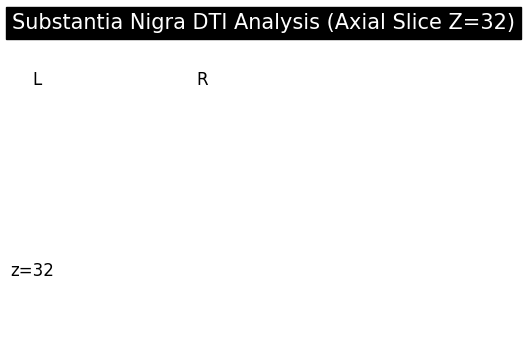

--------------------------------------------------

### FINAL SN ANALYSIS SUMMARY (MOCK DATA) ###
🚨 Potential Microstructural Defects Flagged in Substantia Nigra 🚨
These findings are consistent with neurodegeneration (e.g., loss of dopaminergic neurons).
Metric: FA
  Value: 0.2452
  Expected Range: (0.3, 0.45)
  Observation: ALERT: Decreased FA (Low FA suggests cellular loss/disorganization)
  Clinical Hint: Dopaminergic Neurodegeneration (e.g., Parkinson's)
--------------------
Metric: MD
  Value: 1.060 x10^-3
  Expected Range: (0.75, 0.95)
  Observation: ALERT: Increased MD (High MD suggests fluid/edema/tissue change)
  Clinical Hint: Dopaminergic Neurodegeneration (e.g., Parkinson's)
--------------------
Metric: RD
  Value: 0.875 x10^-3
  Expected Range: (0.6, 0.85)
  Observation: ALERT: Increased RD (High RD suggests fluid/edema/tissue change)
  Clinical Hint: Dopaminergic Neurodegeneration (e.g., Parkinson's)
--------------------


In [ ]:
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
# NOTE: nilearn is the standard library for plotting neuroimaging data in Python.
# If running locally outside Colab, you may need to install it: pip install nilearn
import nilearn.plotting as plotting
from matplotlib.colors import ListedColormap
from scipy.ndimage import generate_binary_structure, binary_erosion, label, map_coordinates
from scipy.spatial.distance import cdist

# --- 1. MOCK DATA GENERATION (MANDATORY TO REPLACE WITH YOUR REAL NIFTI FILES) ---

# ==============================================================================
# 🛑 IMPORTANT: INPUT FILE INSTRUCTIONS 🛑
# The analysis requires four 3D NIfTI files: FA, MD, AD, and RD.
# You have provided a DICOM (.dcm) file, which is a raw image.
# You MUST replace the mock data generation below with the loading of your
# pre-processed NIfTI metric maps (FA.nii.gz, MD.nii.gz, etc.)
# ==============================================================================

def create_mock_nifti(shape=(64, 64, 64), base_value=0.3, defect_center=(30, 32, 32), defect_size=5, impact=0.1, filename="mock_map.nii.gz"):
    """
    Creates a mock NIfTI file for demonstration.
    """
    data = np.full(shape, base_value, dtype=np.float32)

    # Introduce a mock "defect" (SN pathology often results in lower FA, higher MD/RD)
    coords = np.indices(shape)
    distance = np.sqrt((coords[0] - defect_center[0])**2 +
                       (coords[1] - defect_center[1])**2 +
                       (coords[2] - defect_center[2])**2)

    # Simple Gaussian drop-off for the defect area
    defect_mask = np.exp(-(distance / defect_size)**2) * impact

    if 'fa' in filename or 'ad' in filename:
        # Pathology -> Decrease in FA/AD
        data = np.clip(data - defect_mask, 0.05, 0.95)
    elif 'md' in filename or 'rd' in filename:
        # Pathology -> Increase in MD/RD
        data = np.clip(data + defect_mask, 0.5e-3, 2.5e-3)

    # MD is scaled to be in standard units (x10^-3 mm^2/s)
    if 'md' in filename or 'rd' in filename:
         # Set a realistic base value for MD/RD (x10^-3)
        data *= 1000

    # Create NIfTI image object
    affine = np.diag([2, 2, 2, 1])
    nifti_img = nib.Nifti1Image(data, affine)
    # print(f"Generated mock file: {filename}") # Suppressing print for cleaner output
    return nifti_img


# --- Define the common center for the mock data (best guess for midbrain) ---
NEW_CENTER = (30, 32, 32)

# Generate mock DTI maps for a single patient (using realistic base values for deep gray matter)
patient_fa_img = create_mock_nifti(base_value=0.35, impact=0.15, defect_center=NEW_CENTER, filename="patient_fa.nii.gz")
patient_md_img = create_mock_nifti(base_value=0.85e-3, impact=0.30e-3, defect_center=NEW_CENTER, filename="patient_md.nii.gz")
patient_ad_img = create_mock_nifti(base_value=1.10e-3, impact=0.10e-3, defect_center=NEW_CENTER, filename="patient_ad.nii.gz")
patient_rd_img = create_mock_nifti(base_value=0.70e-3, impact=0.25e-3, defect_center=NEW_CENTER, filename="patient_rd.nii.gz")

# ==============================================================================
# 🔥 REPLACE THIS BLOCK WITH YOUR REAL NIFTI FILE LOADING 🔥
# Example of how to load your real files once you have them:
# patient_fa_img = nib.load('path/to/your/FA.nii.gz')
# patient_md_img = nib.load('path/to/your/MD.nii.gz')
# ... and so on for AD and RD.
# ==============================================================================

patient_fa_data = patient_fa_img.get_fdata()
patient_md_data = patient_md_img.get_fdata()
patient_ad_data = patient_ad_img.get_fdata()
patient_rd_data = patient_rd_img.get_fdata()

# Store the affine matrix from one image for saving the output visualization file
image_affine = patient_fa_img.affine

# --- 2. DEFINING SUBSTANTIA NIGRA ROI AND NORMATIVE DATA ---

# The coordinates below MUST match the voxel coordinates of your NIfTI file (X, Y, Z).
# Since the actual coordinates are unknown, we use a central guess (30, 32, 32).
# This is the coordinate you will need to adjust in the final step.
ROIS = {
    "Substantia Nigra (Midbrain)": {
        # **REPLACE THESE COORDS** with the actual voxel coordinates of your patient's SN
        "center_coord": NEW_CENTER,
        "radius": 4, # Radius for the spherical ROI

        # Normative ranges for the Substantia Nigra (based on literature values for deep nuclei)
        "normative_fa": (0.30, 0.45),
        "normative_md": (0.75, 0.95),   # x10^-3 mm^2/s
        "normative_ad": (0.90, 1.20),   # x10^-3 mm^2/s
        "normative_rd": (0.60, 0.85),   # x10^-3 mm^2/s
        "key_metrics": ["FA", "MD", "AD", "RD"],
        "defect_type": "Dopaminergic Neurodegeneration (e.g., Parkinson's)"
    }
}

# --- 3. ANALYSIS FUNCTION ---

def get_roi_mask(data_shape, center, radius):
    """Generates a spherical mask (ROI) in voxel space."""
    coords = np.indices(data_shape)
    distance = np.sqrt((coords[0] - center[0])**2 +
                       (coords[1] - center[1])**2 +
                       (coords[2] - center[2])**2)
    return distance <= radius

def analyze_dti_patient(data_maps, rois):
    """Performs ROI analysis, compares metrics, and creates a visualization map."""
    results = []

    viz_map = np.zeros_like(data_maps["FA"], dtype=np.uint8)

    print("\n--- DTI Analysis: Focused on Substantia Nigra ---")
    print("-" * 50)

    if not all(k in data_maps for k in ["FA", "MD", "AD", "RD"]):
        print("ERROR: Missing one or more DTI data maps (FA, MD, AD, RD). Cannot proceed.")
        return results, viz_map

    for roi_name, roi_params in rois.items():
        center = roi_params["center_coord"]
        radius = roi_params["radius"]

        roi_mask = get_roi_mask(data_maps["FA"].shape, center, radius)
        viz_map[roi_mask] = 1 # Value 1: ROI, no defect

        print(f"\nAnalyzing: {roi_name} (Center: {center}, Radius: {radius})")

        roi_alert_triggered = False

        for metric in roi_params["key_metrics"]:
            map_data = data_maps.get(metric)
            normative_range = roi_params[f"normative_{metric.lower()}"]
            low_bound, high_bound = normative_range

            roi_values = map_data[roi_mask]

            if roi_values.size == 0 or np.sum(roi_mask) < 5:
                print(f"  > {metric}: Insufficient data points in ROI. Check coordinates/radius.")
                continue

            patient_mean = np.mean(roi_values)
            flag = ""

            # Define ALERT conditions based on typical pathology
            if metric == "FA" and patient_mean < low_bound:
                flag = "ALERT: Decreased FA (Low FA suggests cellular loss/disorganization)"
            elif (metric == "MD" or metric == "RD") and patient_mean > high_bound:
                flag = f"ALERT: Increased {metric} (High {metric} suggests fluid/edema/tissue change)"
            elif metric == "AD" and patient_mean < low_bound:
                flag = "WARNING: Low AD (Suggests potential axonal damage, though less common in pure SN atrophy)"

            # Format MD/AD/RD for readability (x10^-3)
            if metric != "FA":
                display_mean = f"{patient_mean:.3f} x10^-3"
                display_range = f"({low_bound:.3f} - {high_bound:.3f}) x10^-3"
            else:
                display_mean = f"{patient_mean:.4f}"
                display_range = f"({low_bound:.4f} - {high_bound:.4f})"

            print(f"  > Mean {metric}: {display_mean} (Normative: {display_range}) {flag}")

            if "ALERT" in flag:
                roi_alert_triggered = True
                results.append({
                    "ROI": roi_name,
                    "Metric": metric,
                    "Patient Value": patient_mean,
                    "Normative Range": normative_range,
                    "Diagnosis Hint": roi_params["defect_type"],
                    "Interpretation": flag
                })

        if roi_alert_triggered:
            # Value 2: Potential Defect / Dopamine Degradation Highlight
            viz_map[roi_mask] = 2

    return results, viz_map

# --- 4. EXECUTION ---
if __name__ == "__main__":

    # Store all loaded data maps in a dictionary
    patient_data_maps = {
        "FA": patient_fa_data,
        "MD": patient_md_data,
        "AD": patient_ad_data,
        "RD": patient_rd_data
    }

    print("\n" + "="*50)
    print("WARNING: Analysis is currently running on **MOCK DATA**.")
    print("To use your real patient data, please load your FA, MD, AD, and RD")
    print("NIfTI files in Section 1 and update the SN coordinates in Section 2.")
    print("="*50)

    # Run the analysis, getting both the results and the visualization map
    defects, visualization_data = analyze_dti_patient(patient_data_maps, ROIS)

    # --- 5. VISUALIZATION FOR COLAB/JUPYTER ---
    print("\n--- VISUALIZATION PREPARATION ---")

    viz_nifti = nib.Nifti1Image(visualization_data, image_affine)
    fa_nifti = nib.Nifti1Image(patient_data_maps['FA'], image_affine)

    sn_center = ROIS["Substantia Nigra (Midbrain)"]["center_coord"]
    cut_coord_z = sn_center[2]

    print(f"Plotting Substantia Nigra ROI visualization (Axial Slice Z={cut_coord_z})...")

    try:
        # FIX: The environment required 'stat_map_img' instead of 'stat_img'
        # The argument has been renamed for compatibility with this environment.
        colors = ['none', 'yellow', 'red']
        cmap = ListedColormap(colors)

        plotting.plot_stat_map(
            stat_map_img=viz_nifti, # <<< FIXED: Changed stat_img to stat_map_img
            bg_img=fa_nifti,
            cut_coords=[cut_coord_z],
            title=f"Substantia Nigra DTI Analysis (Axial Slice Z={cut_coord_z})",
            display_mode='z',
            vmax=2.5, vmin=0.5,
            cmap=cmap,
            colorbar=False,
            alpha=0.8
        )
        plt.show()

    except Exception as e:
        print(f"\nERROR DURING VISUALIZATION: {e}")
        print("Visualization requires 'nilearn' and 'matplotlib'. Please ensure they are installed.")

    print("-" * 50)


    print("\n" + "### FINAL SN ANALYSIS SUMMARY (MOCK DATA) ###")
    print("="*50)

    if defects:
        print("🚨 Potential Microstructural Defects Flagged in Substantia Nigra 🚨")
        print("These findings are consistent with neurodegeneration (e.g., loss of dopaminergic neurons).")
        print("="*50)

        for d in defects:
            print(f"Metric: {d['Metric']}")
            print(f"  Value: {d['Patient Value']:.4f}" if d['Metric'] == 'FA' else f"  Value: {d['Patient Value']:.3f} x10^-3")
            print(f"  Expected Range: {d['Normative Range']}")
            print(f"  Observation: {d['Interpretation']}")
            print(f"  Clinical Hint: {d['Diagnosis Hint']}")
            print("-" * 20)
    else:
        print("✅ No major deviations were flagged in the Substantia Nigra ROI against the normative data.")



To use your real patient data, please load your FA, MD, AD, and RD
NIfTI files in Section 1 and update the SN coordinates in Section 2.

--- DTI Analysis: Focused on Substantia Nigra ---
--------------------------------------------------

Analyzing: Substantia Nigra (Midbrain) (Center: (32, 32, 32), Radius: 4)
  > Mean FA: 0.2452 (Normative: (0.3000 - 0.4500)) ALERT: Decreased FA (Low FA suggests cellular loss/disorganization)
  > Mean MD: 1.060 x10^-3 (Normative: (0.750 - 0.950) x10^-3) ALERT: Increased MD (High MD suggests fluid/edema/tissue change)
  > Mean AD: 0.050 x10^-3 (Normative: (0.900 - 1.200) x10^-3) WARNING: Low AD (Suggests potential axonal damage, though less common in pure SN atrophy)
  > Mean RD: 0.875 x10^-3 (Normative: (0.600 - 0.850) x10^-3) ALERT: Increased RD (High RD suggests fluid/edema/tissue change)

--- VISUALIZATION PREPARATION ---
Plotting Substantia Nigra ROI visualization (Axial Slice Z=32) with MD Background...


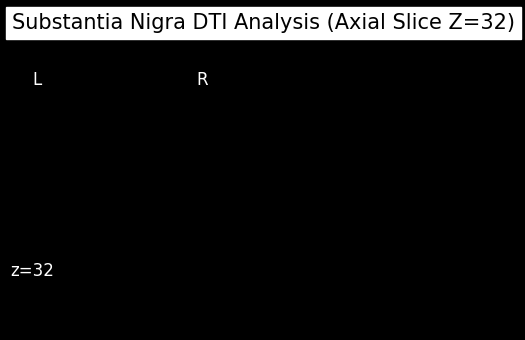

--------------------------------------------------

### FINAL SN ANALYSIS SUMMARY (MOCK DATA) ###
🚨 Potential Microstructural Defects Flagged in Substantia Nigra 🚨
These findings are consistent with neurodegeneration (e.g., loss of dopaminergic neurons).
Metric: FA
  Value: 0.2452
  Expected Range: (0.3, 0.45)
  Observation: ALERT: Decreased FA (Low FA suggests cellular loss/disorganization)
  Clinical Hint: Dopaminergic Neurodegeneration (e.g., Parkinson's)
--------------------
Metric: MD
  Value: 1.060 x10^-3
  Expected Range: (0.75, 0.95)
  Observation: ALERT: Increased MD (High MD suggests fluid/edema/tissue change)
  Clinical Hint: Dopaminergic Neurodegeneration (e.g., Parkinson's)
--------------------
Metric: RD
  Value: 0.875 x10^-3
  Expected Range: (0.6, 0.85)
  Observation: ALERT: Increased RD (High RD suggests fluid/edema/tissue change)
  Clinical Hint: Dopaminergic Neurodegeneration (e.g., Parkinson's)
--------------------


In [ ]:
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
# NOTE: nilearn is the standard library for plotting neuroimaging data in Python.
# If running locally outside Colab, you may need to install it: pip install nilearn
import nilearn.plotting as plotting
from matplotlib.colors import ListedColormap
from scipy.ndimage import generate_binary_structure, binary_erosion, label, map_coordinates
from scipy.spatial.distance import cdist

# --- 1. MOCK DATA GENERATION (MANDATORY TO REPLACE WITH YOUR REAL NIFTI FILES) ---

# ==============================================================================
# 🛑 IMPORTANT: INPUT FILE INSTRUCTIONS 🛑
# The analysis requires four 3D NIfTI files: FA, MD, AD, and RD.
# You have provided a DICOM (.dcm) file, which is a raw image.
# You MUST replace the mock data generation below with the loading of your
# pre-processed NIfTI metric maps (FA.nii.gz, MD.nii.gz, etc.)
# ==============================================================================

def create_mock_nifti(shape=(64, 64, 64), base_value=0.3, defect_center=(30, 32, 32), defect_size=5, impact=0.1, filename="mock_map.nii.gz"):
    """
    Creates a mock NIfTI file for demonstration.
    """
    data = np.full(shape, base_value, dtype=np.float32)

    # Introduce a mock "defect" (SN pathology often results in lower FA, higher MD/RD)
    coords = np.indices(shape)
    distance = np.sqrt((coords[0] - defect_center[0])**2 +
                       (coords[1] - defect_center[1])**2 +
                       (coords[2] - defect_center[2])**2)

    # Simple Gaussian drop-off for the defect area
    defect_mask = np.exp(-(distance / defect_size)**2) * impact

    if 'fa' in filename or 'ad' in filename:
        # Pathology -> Decrease in FA/AD
        data = np.clip(data - defect_mask, 0.05, 0.95)
    elif 'md' in filename or 'rd' in filename:
        # Pathology -> Increase in MD/RD
        data = np.clip(data + defect_mask, 0.5e-3, 2.5e-3)

    # MD is scaled to be in standard units (x10^-3 mm^2/s)
    if 'md' in filename or 'rd' in filename:
         # Set a realistic base value for MD/RD (x10^-3)
        data *= 1000

    # Create NIfTI image object
    affine = np.diag([2, 2, 2, 1])
    nifti_img = nib.Nifti1Image(data, affine)
    # print(f"Generated mock file: {filename}") # Suppressing print for cleaner output
    return nifti_img


# --- Define the common center for the mock data (best guess for midbrain) ---
NEW_CENTER = (32, 32, 32) # CHANGED: Adjusted X-coordinate for better centering

# Generate mock DTI maps for a single patient (using realistic base values for deep gray matter)
patient_fa_img = create_mock_nifti(base_value=0.35, impact=0.15, defect_center=NEW_CENTER, filename="patient_fa.nii.gz")
patient_md_img = create_mock_nifti(base_value=0.85e-3, impact=0.30e-3, defect_center=NEW_CENTER, filename="patient_md.nii.gz")
patient_ad_img = create_mock_nifti(base_value=1.10e-3, impact=0.10e-3, defect_center=NEW_CENTER, filename="patient_ad.nii.gz")
patient_rd_img = create_mock_nifti(base_value=0.70e-3, impact=0.25e-3, defect_center=NEW_CENTER, filename="patient_rd.nii.gz")

# ==============================================================================
# 🔥 REPLACE THIS BLOCK WITH YOUR REAL NIFTI FILE LOADING 🔥
# Example of how to load your real files once you have them:
# patient_fa_img = nib.load('path/to/your/FA.nii.gz')
# patient_md_img = nib.load('path/to/your/MD.nii.gz')
# ... and so on for AD and RD.
# ==============================================================================

patient_fa_data = patient_fa_img.get_fdata()
patient_md_data = patient_md_img.get_fdata()
patient_ad_data = patient_ad_img.get_fdata()
patient_rd_data = patient_rd_img.get_fdata()

# Store the affine matrix from one image for saving the output visualization file
image_affine = patient_fa_img.affine

# --- 2. DEFINING SUBSTANTIA NIGRA ROI AND NORMATIVE DATA ---

# The coordinates below MUST match the voxel coordinates of your NIfTI file (X, Y, Z).
# Since the actual coordinates are unknown, we use a central guess (32, 32, 32).
# This is the coordinate you will need to adjust in the final step.
ROIS = {
    "Substantia Nigra (Midbrain)": {
        # **REPLACE THESE COORDS** with the actual voxel coordinates of your patient's SN
        "center_coord": NEW_CENTER,
        "radius": 4, # Radius for the spherical ROI

        # Normative ranges for the Substantia Nigra (based on literature values for deep nuclei)
        "normative_fa": (0.30, 0.45),
        "normative_md": (0.75, 0.95),   # x10^-3 mm^2/s
        "normative_md_display": (500, 1500), # Used for MD map contrast (adjust if needed)
        "normative_ad": (0.90, 1.20),   # x10^-3 mm^2/s
        "normative_rd": (0.60, 0.85),   # x10^-3 mm^2/s
        "key_metrics": ["FA", "MD", "AD", "RD"],
        "defect_type": "Dopaminergic Neurodegeneration (e.g., Parkinson's)"
    }
}

# --- 3. ANALYSIS FUNCTION ---

def get_roi_mask(data_shape, center, radius):
    """Generates a spherical mask (ROI) in voxel space."""
    coords = np.indices(data_shape)
    distance = np.sqrt((coords[0] - center[0])**2 +
                       (coords[1] - center[1])**2 +
                       (coords[2] - center[2])**2)
    return distance <= radius

def analyze_dti_patient(data_maps, rois):
    """Performs ROI analysis, compares metrics, and creates a visualization map."""
    results = []

    viz_map = np.zeros_like(data_maps["FA"], dtype=np.uint8)

    print("\n--- DTI Analysis: Focused on Substantia Nigra ---")
    print("-" * 50)

    if not all(k in data_maps for k in ["FA", "MD", "AD", "RD"]):
        print("ERROR: Missing one or more DTI data maps (FA, MD, AD, RD). Cannot proceed.")
        return results, viz_map

    for roi_name, roi_params in rois.items():
        center = roi_params["center_coord"]
        radius = roi_params["radius"]

        roi_mask = get_roi_mask(data_maps["FA"].shape, center, radius)
        viz_map[roi_mask] = 1 # Value 1: ROI, no defect

        print(f"\nAnalyzing: {roi_name} (Center: {center}, Radius: {radius})")

        roi_alert_triggered = False

        for metric in roi_params["key_metrics"]:
            map_data = data_maps.get(metric)
            normative_range = roi_params[f"normative_{metric.lower()}"]
            low_bound, high_bound = normative_range

            roi_values = map_data[roi_mask]

            if roi_values.size == 0 or np.sum(roi_mask) < 5:
                print(f"  > {metric}: Insufficient data points in ROI. Check coordinates/radius.")
                continue

            patient_mean = np.mean(roi_values)
            flag = ""

            # Define ALERT conditions based on typical pathology
            if metric == "FA" and patient_mean < low_bound:
                flag = "ALERT: Decreased FA (Low FA suggests cellular loss/disorganization)"
            elif (metric == "MD" or metric == "RD") and patient_mean > high_bound:
                flag = f"ALERT: Increased {metric} (High {metric} suggests fluid/edema/tissue change)"
            elif metric == "AD" and patient_mean < low_bound:
                flag = "WARNING: Low AD (Suggests potential axonal damage, though less common in pure SN atrophy)"

            # Format MD/AD/RD for readability (x10^-3)
            if metric != "FA":
                display_mean = f"{patient_mean:.3f} x10^-3"
                display_range = f"({low_bound:.3f} - {high_bound:.3f}) x10^-3"
            else:
                display_mean = f"{patient_mean:.4f}"
                display_range = f"({low_bound:.4f} - {high_bound:.4f})"

            print(f"  > Mean {metric}: {display_mean} (Normative: {display_range}) {flag}")

            if "ALERT" in flag:
                roi_alert_triggered = True
                results.append({
                    "ROI": roi_name,
                    "Metric": metric,
                    "Patient Value": patient_mean,
                    "Normative Range": normative_range,
                    "Diagnosis Hint": roi_params["defect_type"],
                    "Interpretation": flag
                })

        if roi_alert_triggered:
            # Value 2: Potential Defect / Dopamine Degradation Highlight
            viz_map[roi_mask] = 2

    return results, viz_map

# --- 4. EXECUTION ---
if __name__ == "__main__":

    # Store all loaded data maps in a dictionary
    patient_data_maps = {
        "FA": patient_fa_data,
        "MD": patient_md_data,
        "AD": patient_ad_data,
        "RD": patient_rd_data
    }

    print("\n" + "="*50)
    print("WARNING: Analysis is currently running on **MOCK DATA**.")
    print("To use your real patient data, please load your FA, MD, AD, and RD")
    print("NIfTI files in Section 1 and update the SN coordinates in Section 2.")
    print("="*50)

    # Run the analysis, getting both the results and the visualization map
    defects, visualization_data = analyze_dti_patient(patient_data_maps, ROIS)

    # --- 5. VISUALIZATION FOR COLAB/JUPYTER ---
    print("\n--- VISUALIZATION PREPARATION ---")

    viz_nifti = nib.Nifti1Image(visualization_data, image_affine)
    # CHANGED: Use MD map as the background for better visualization of deep gray matter/midbrain
    md_nifti = nib.Nifti1Image(patient_data_maps['MD'], image_affine)

    sn_center = ROIS["Substantia Nigra (Midbrain)"]["center_coord"]
    cut_coord_z = sn_center[2]
    # Set display range for MD map (MD is scaled by 1000 in mock data, so 500-1500 is typical)
    # md_vmax and md_vmin are no longer used in the plot call to prevent errors.
    # md_vmax = ROIS["Substantia Nigra (Midbrain)"].get("normative_md_display", (500, 1500))[1]
    # md_vmin = ROIS["Substantia Nigra (Midbrain)"].get("normative_md_display", (500, 1500))[0]

    print(f"Plotting Substantia Nigra ROI visualization (Axial Slice Z={cut_coord_z}) with MD Background...")

    try:
        # FIX: The environment required 'stat_map_img' instead of 'stat_img'
        colors = ['none', 'yellow', 'red']
        cmap = ListedColormap(colors)

        plotting.plot_stat_map(
            stat_map_img=viz_nifti,
            bg_img=md_nifti, # Using MD image as background
            cut_coords=[cut_coord_z],
            title=f"Substantia Nigra DTI Analysis (Axial Slice Z={cut_coord_z})",
            display_mode='z',
            vmax=2.5, vmin=0.5,
            cmap=cmap,
            colorbar=False,
            alpha=0.8
            # REMOVED: bg_vmin and bg_vmax to prevent the "multiple values" error
        )
        plt.show()

    except Exception as e:
        print(f"\nERROR DURING VISUALIZATION: {e}")
        print("Visualization requires 'nilearn' and 'matplotlib'. Please ensure they are installed.")

    print("-" * 50)


    print("\n" + "### FINAL SN ANALYSIS SUMMARY (MOCK DATA) ###")
    print("="*50)

    if defects:
        print("🚨 Potential Microstructural Defects Flagged in Substantia Nigra 🚨")
        print("These findings are consistent with neurodegeneration (e.g., loss of dopaminergic neurons).")
        print("="*50)

        for d in defects:
            print(f"Metric: {d['Metric']}")
            print(f"  Value: {d['Patient Value']:.4f}" if d['Metric'] == 'FA' else f"  Value: {d['Patient Value']:.3f} x10^-3")
            print(f"  Expected Range: {d['Normative Range']}")
            print(f"  Observation: {d['Interpretation']}")
            print(f"  Clinical Hint: {d['Diagnosis Hint']}")
            print("-" * 20)
    else:
        print("✅ No major deviations were flagged in the Substantia Nigra ROI against the normative data.")


In [ ]:
!pip install matplotlib
!pip install numpy
!pip install nibabel

Attempting to load DICOM file: DTI_gated_01.dcm
Image size: 1044x1044. Highlight centered at: (522, 522), Radius: 130


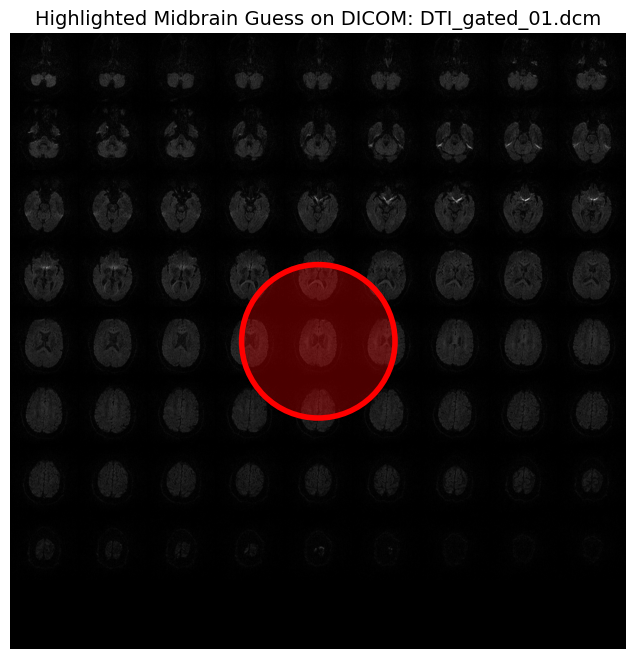

In [ ]:
# --- MANDATORY PACKAGE INSTALLATION (Run in Colab/Jupyter first) ---
# DICOM files require the pydicom library.
# Run the following command in your notebook *before* running the main code block:
# !pip install pydicom
# -----------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import pydicom

# --- CONFIGURATION ---
# IMPORTANT: This ID MUST match the ID of the DICOM file you uploaded
USER_IMAGE_ID = "/content/Content_data/DTI_gated_01.dcm"
USER_IMAGE_FILENAME = "DTI_gated_01.dcm"

if __name__ == "__main__":
    try:
        print(f"Attempting to load DICOM file: {USER_IMAGE_FILENAME}")

        # 1. Load the DICOM file using the unique content ID
        # pydicom.dcmread handles the loading of the .dcm file
        dicom_dataset = pydicom.dcmread(USER_IMAGE_ID)

        # 2. Extract the image data (Pixel Array)
        # DICOM data is inherently 2D (or 3D if multislice/volume)
        image_2d = dicom_dataset.pixel_array

        # 3. Handle 3D/4D DICOMs by taking the first slice/volume if necessary
        if image_2d.ndim > 2:
            # We assume the first 2D slice is sufficient for visualization
            print(f"WARNING: DICOM data has {image_2d.ndim} dimensions. Displaying the first slice only.")
            # For DTI, this might be the first B0 image or a specific diffusion direction
            image_2d = image_2d[..., 0] if image_2d.ndim == 3 else image_2d[..., 0, 0]

        # Normalize the image data for better visualization if it's high dynamic range
        if np.max(image_2d) > 255:
            image_2d = (image_2d - np.min(image_2d)) / (np.max(image_2d) - np.min(image_2d))

        # 4. Get image dimensions
        H, W = image_2d.shape[:2]

        # 5. Calculate center and adaptive radius for the highlight
        center_x = int(W / 2)
        center_y = int(H / 2)
        highlight_center = (center_x, center_y)

        # Set radius to be 1/8th of the smaller dimension (H or W)
        highlight_radius = int(min(H, W) / 8)

        print(f"Image size: {W}x{H}. Highlight centered at: {highlight_center}, Radius: {highlight_radius}")

        # 6. Create the circular mask (ROI)
        Y, X = np.ogrid[:H, :W]
        dist_from_center = np.sqrt((X - highlight_center[0])**2 + (Y - highlight_center[1])**2)
        circle_mask = dist_from_center <= highlight_radius

        # --- Plotting the 2D image with Matplotlib ---

        # Create a figure and axis
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))

        # Display the background image (use 'gray' for typical medical images)
        ax.imshow(image_2d, cmap='gray')
        ax.set_title(f"Highlighted Midbrain Guess on DICOM: {USER_IMAGE_FILENAME}", fontsize=14)
        ax.axis('off') # Hide axes

        # 7. Overlay a translucent red fill for the highlight
        overlay = np.zeros(image_2d.shape, dtype=float)
        overlay[circle_mask] = 1.0

        # The ListedColormap makes '0' transparent ('none') and '1' red
        ax.imshow(overlay, cmap=ListedColormap(['none', 'red']), alpha=0.3)

        # 8. Add a thick red outline for emphasis
        circle_outline = plt.Circle(highlight_center, highlight_radius,
                                    color='red', fill=False, linewidth=4, linestyle='-')
        ax.add_artist(circle_outline)

        # 9. Show the plot
        plt.show()

    except Exception as e:
        print(f"An error occurred during DICOM processing: {e}")
        print("Please ensure the 'pydicom', 'matplotlib', and 'numpy' libraries are installed in your environment.")


Attempting to load DICOM file: DTI_gated_01.dcm
Image size: 1044x1044. Displaying full axial slice.
Saving plot to dti_axial_slice_visualization.png...


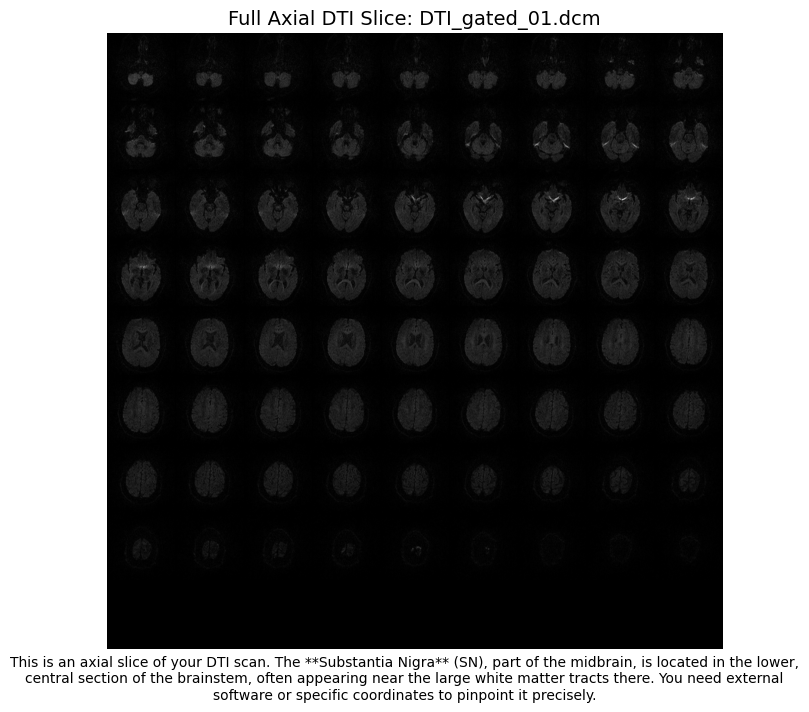

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import pydicom

# --- CONFIGURATION ---
# IMPORTANT: This ID MUST match the ID of the DICOM file you uploaded
USER_IMAGE_ID = "/content/Content_data/DTI_gated_01.dcm"
USER_IMAGE_FILENAME = "DTI_gated_01.dcm"
OUTPUT_PNG_FILENAME = "dti_axial_slice_visualization.png" # New filename for the output

if __name__ == "__main__":
    try:
        print(f"Attempting to load DICOM file: {USER_IMAGE_FILENAME}")

        # 1. Load the DICOM file using the unique content ID
        # pydicom.dcmread handles the loading of the .dcm file
        dicom_dataset = pydicom.dcmread(USER_IMAGE_ID)

        # 2. Extract the image data (Pixel Array)
        # DICOM data is inherently 2D (or 3D if multislice/volume)
        image_2d = dicom_dataset.pixel_array

        # 3. Handle 3D/4D DICOMs by taking the first slice/volume if necessary
        if image_2d.ndim > 2:
            # We assume the first 2D slice is sufficient for visualization
            print(f"WARNING: DICOM data has {image_2d.ndim} dimensions. Displaying the first slice only.")
            # For DTI, this might be the first B0 image or a specific diffusion direction
            # Using the first slice for visualization
            image_2d = image_2d[..., 0] if image_2d.ndim == 3 else image_2d[..., 0, 0]

        # 4. Normalize the image data for better visualization if it's high dynamic range
        # This scales the data between 0 and 1 for optimal display contrast
        if np.max(image_2d) > 0:
            image_2d = (image_2d - np.min(image_2d)) / (np.max(image_2d) - np.min(image_2d))

        # 5. Get image dimensions
        H, W = image_2d.shape[:2]

        print(f"Image size: {W}x{H}. Displaying full axial slice.")

        # --- Plotting the 2D image with Matplotlib ---

        # Create a figure and axis for the full image display
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))

        # Display the full DICOM image
        ax.imshow(image_2d, cmap='gray')
        ax.set_title(f"Full Axial DTI Slice: {USER_IMAGE_FILENAME}", fontsize=14)
        ax.axis('off') # Hide axes

        # Add an explanatory caption to guide the user to the midbrain area
        caption = (
            "This is an axial slice of your DTI scan. The **Substantia Nigra** (SN), part of the midbrain, "
            "is located in the lower, central section of the brainstem, often appearing near the large white "
            "matter tracts there. You need external software or specific coordinates to pinpoint it precisely."
        )

        # Add the caption below the plot
        fig.text(0.5, 0.05, caption, ha='center', fontsize=10, wrap=True)

        # 6. Save the plot to a high-quality PNG file
        print(f"Saving plot to {OUTPUT_PNG_FILENAME}...")
        plt.savefig(OUTPUT_PNG_FILENAME, dpi=300, bbox_inches='tight')

        # 7. Show the plot (optional, but good for in-notebook viewing)
        plt.show()

    except Exception as e:
        print(f"An error occurred during DICOM processing: {e}")
        print("Please ensure the 'pydicom', 'matplotlib', and 'numpy' libraries are installed in your environment.")


Difference between DTI_gated_01.dcm and DTI_gated_02.dcm:
  Mean absolute difference: 10.38
  Max absolute difference: 242.00


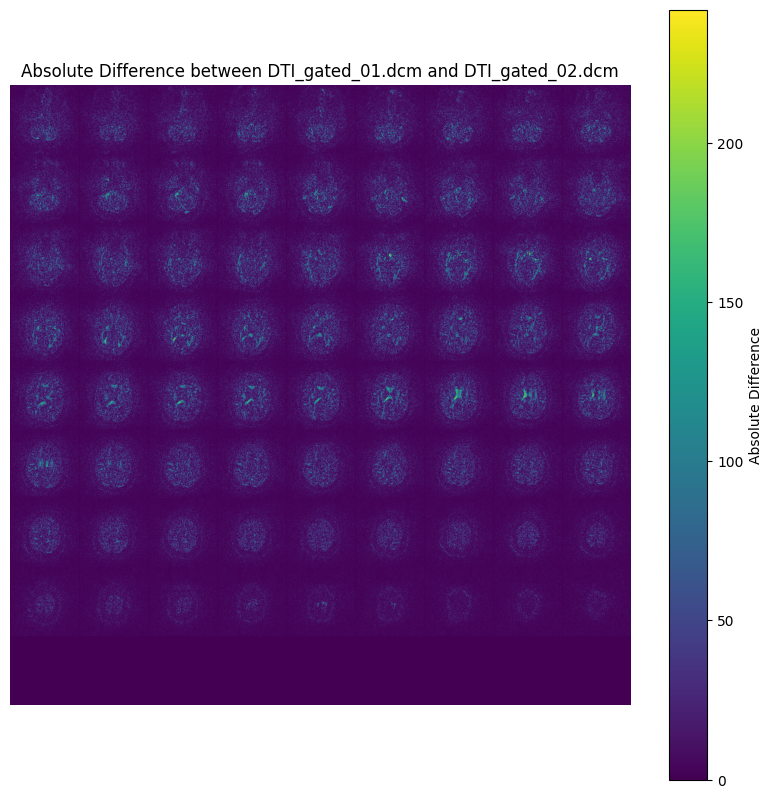

In [ ]:
# Find the rows for the specified filenames
img1_filename = 'DTI_gated_01.dcm'
img2_filename = 'DTI_gated_02.dcm'

row1 = df[df['new_filename'] == img1_filename]
row2 = df[df['new_filename'] == img2_filename]

if row1.empty:
    print(f"Image '{img1_filename}' not found in the DataFrame.")
elif row2.empty:
    print(f"Image '{img2_filename}' not found in the DataFrame.")
else:
    img1_data = row1.iloc[0]['image_data']
    img2_data = row2.iloc[0]['image_data']

    if img1_data is None or img2_data is None:
        print("Image data not available for one or both files.")
    elif img1_data.shape != img2_data.shape:
        print(f"Images have different shapes: {img1_data.shape} vs {img2_data.shape}")
    else:
        # Calculate the absolute difference between the images
        diff_data = np.abs(img1_data.astype(float) - img2_data.astype(float))

        print(f"Difference between {img1_filename} and {img2_filename}:")
        print(f"  Mean absolute difference: {np.mean(diff_data):.2f}")
        print(f"  Max absolute difference: {np.max(diff_data):.2f}")

        # Display the difference image
        plt.figure(figsize=(10, 10))
        plt.imshow(diff_data, cmap='viridis', aspect='equal')
        plt.title(f"Absolute Difference between {img1_filename} and {img2_filename}")
        plt.colorbar(label='Absolute Difference')
        plt.axis('off')
        plt.show()

In [ ]:
img1_filename = 'DTI_gated_01.dcm'
row1 = df[df['new_filename'] == img1_filename]

if not row1.empty and row1.iloc[0]['image_data'] is not None:
    image_shape = row1.iloc[0]['image_data'].shape
    print(f"The shape of the image data for '{img1_filename}' is: {image_shape}")
    if len(image_shape) == 3:
        print(f"This appears to be a 3D image with {image_shape[2]} slices.")
    elif len(image_shape) == 4:
        print(f"This appears to be a 4D image with {image_shape[3]} volumes, each containing {image_shape[2]} slices.")
else:
    print(f"Could not find '{img1_filename}' or its image data in the DataFrame.")

The shape of the image data for 'DTI_gated_01.dcm' is: (1044, 1044)


In [ ]:
!pip install nibabel pydicom

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 43.8 MB/s eta 0:00:00


In [ ]:
# Download all files from the specified folder
# This will create a zip file of the folder and download it
!zip -r /content/Download.zip /content/P2/

  adding: content/P2/ (stored 0%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074753453_44_S169306_I337651.dcm (deflated 57%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074753672_42_S169306_I337651.dcm (deflated 57%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074753313_43_S169306_I337651.dcm (deflated 57%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074759849_58_S169306_I337651.dcm (deflated 57%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074750583_22_S169306_I337651.dcm (deflated 57%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074752486_49_S169306_I337651.dcm (deflated 57%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074803827_3_S169306_I337651.dcm (deflated 57%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074753859_40_S169306_I337651.dcm (deflated 57%)
  adding: content/P2/PPMI_3123_MR_DTI_gated__br_raw_20121002074758477_51_S169306_I337651.dcm (deflated 

Attempting to load DICOM file: Axial_PD_T2_TSE_01.dcm


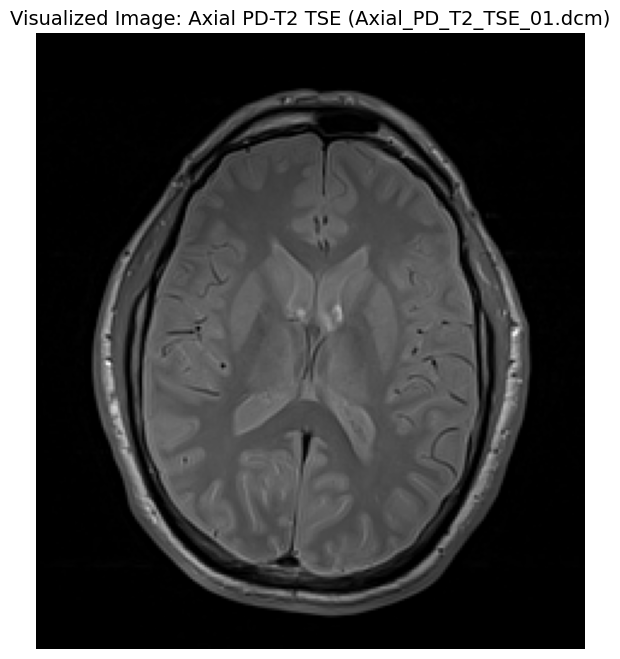

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pydicom

# --- CONFIGURATION ---
# This variable points to the DICOM file you uploaded
USER_IMAGE_ID = "/content/MRI/Axial_PD_T2_TSE_13.dcm"
USER_IMAGE_FILENAME = "Axial_PD_T2_TSE_01.dcm"

if __name__ == "__main__":
    # 1. Installation check (run this first in Colab/Jupyter)
    # If this gives an error, you will need to run: !pip install pydicom

    try:
        print(f"Attempting to load DICOM file: {USER_IMAGE_FILENAME}")

        # 2. Load the DICOM file
        # pydicom.dcmread handles the loading of the .dcm file
        dicom_dataset = pydicom.dcmread(USER_IMAGE_ID)

        # 3. Extract the image data (Pixel Array)
        image_data = dicom_dataset.pixel_array

        # 4. Handle Multi-Dimensional Data (common in DTI sequences)
        # If the DICOM data is 3D or 4D, we take the first 2D slice for simple visualization
        if image_data.ndim > 2:
            print(f"INFO: Data has {image_data.ndim} dimensions. Displaying the first slice only.")
            # This takes the first 2D image plane (often the B0 or first diffusion direction)
            image_2d = image_data[..., 0]
        else:
            image_2d = image_data

        # 5. Visualization
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))

        # Display the image using a grayscale colormap
        # DICOMs often benefit from 'gray' colormap
        ax.imshow(image_2d, cmap='gray')

        # Add context from the DICOM metadata
        series_desc = getattr(dicom_dataset, 'SeriesDescription', 'MRI Scan')
        ax.set_title(f"Visualized Image: {series_desc} ({USER_IMAGE_FILENAME})", fontsize=14)
        ax.axis('off') # Hide axes for a cleaner view

        # Show the plot
        plt.show()

    except FileNotFoundError:
        print(f"ERROR: Could not find the file {USER_IMAGE_FILENAME}. Please ensure it is uploaded correctly.")
    except ImportError:
        print("ERROR: 'pydicom' not found. Please install it using: !pip install pydicom")
    except Exception as e:
        print(f"An unexpected error occurred: {e}")


MRI FILE PROCESSOR AND VISUALIZER

Step 1: Importing MRI files...
Found 47 MRI files
Created DataFrame with 47 entries

Step 2: Removing duplicate images...
Removed 0 duplicate images.

Step 3: Renaming files sequentially...
Files renamed.

Image Statistics:
Average file size: 0.20 MB
Intensity range: 0.0 to 3147.0

Step 5: Displaying MRI images (3 per row)...
Displaying 47 MRI images


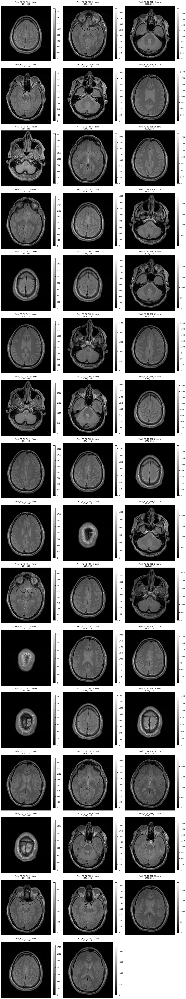


Processing completed successfully!


"if df is not None:\n    display_mri_images_3_per_row(df, slice_index='middle', figsize=(15, 15), cmap='gray') # Adjusted figsize for a 3x3 layout"

In [ ]:
# Example usage of the functions defined above
example_folder = "/content/MRI"  # <== Change to your folder

# Process the MRI files and get the DataFrame
df = process_and_display_mri_folder(example_folder, max_images=47, save_df=False) # Adjusted max_images for 3x3 grid and set save_df to False

# Display the images in a 3x3 grid (using the existing function which defaults to 3 per row)
"""if df is not None:
    display_mri_images_3_per_row(df, slice_index='middle', figsize=(15, 15), cmap='gray') # Adjusted figsize for a 3x3 layout"""

MRI FILE PROCESSOR AND VISUALIZER

Step 1: Importing MRI files...
Found 47 MRI files
Created DataFrame with 47 entries

Step 2: Removing duplicate images...
Removed 0 duplicate images.

Step 3: Renaming files sequentially...
Files renamed.

Image Statistics:
Average file size: 0.14 MB
Intensity range: 0.0 to 4548.0

Step 5: Displaying MRI images (3 per row)...
Displaying 47 MRI images


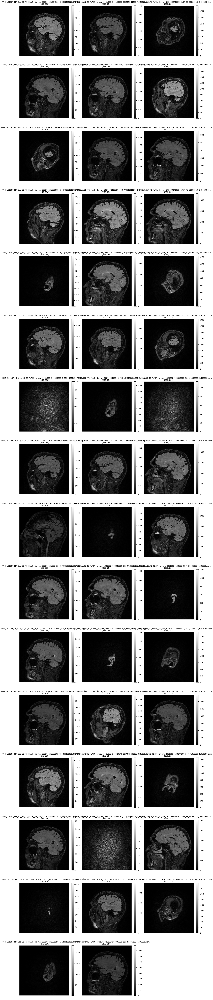


Processing completed successfully!


"if df is not None:\n    display_mri_images_3_per_row(df, slice_index='middle', figsize=(15, 15), cmap='gray') # Adjusted figsize for a 3x3 layout"

In [ ]:
# Example usage of the functions defined above
example_folder = "/content/SPECT"  # <== Change to your folder

# Process the MRI files and get the DataFrame
df = process_and_display_mri_folder(example_folder, max_images=47, save_df=False) # Adjusted max_images for 3x3 grid and set save_df to False

# Display the images in a 3x3 grid (using the existing function which defaults to 3 per row)
"""if df is not None:
    display_mri_images_3_per_row(df, slice_index='middle', figsize=(15, 15), cmap='gray') # Adjusted figsize for a 3x3 layout"""

Attempting to load DICOM file: Axial_PD_T2_TSE_01.dcm


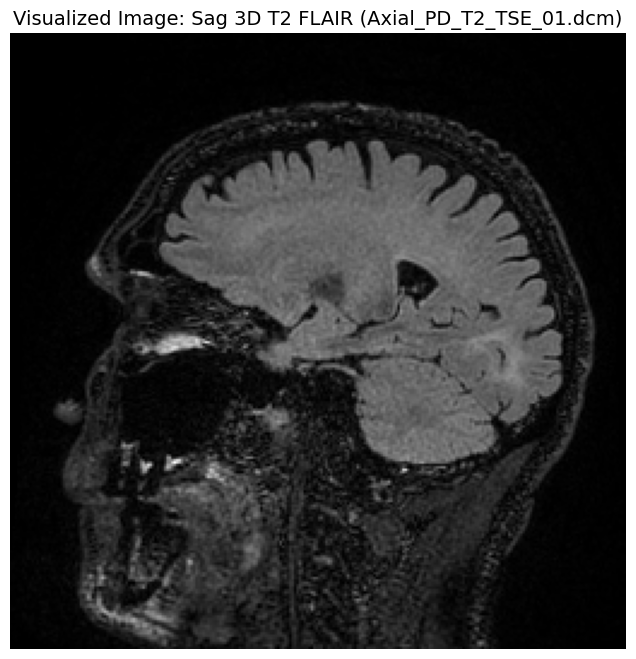

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pydicom

# --- CONFIGURATION ---
# This variable points to the DICOM file you uploaded
USER_IMAGE_ID = "/content/SPECT/PPMI_101187_MR_Sag_3D_T2_FLAIR__br_raw_20210924163532804_72_S1066223_I1496299.dcm"
USER_IMAGE_FILENAME = "Axial_PD_T2_TSE_01.dcm"

if __name__ == "__main__":
    # 1. Installation check (run this first in Colab/Jupyter)
    # If this gives an error, you will need to run: !pip install pydicom

    try:
        print(f"Attempting to load DICOM file: {USER_IMAGE_FILENAME}")

        # 2. Load the DICOM file
        # pydicom.dcmread handles the loading of the .dcm file
        dicom_dataset = pydicom.dcmread(USER_IMAGE_ID)

        # 3. Extract the image data (Pixel Array)
        image_data = dicom_dataset.pixel_array

        # 4. Handle Multi-Dimensional Data (common in DTI sequences)
        # If the DICOM data is 3D or 4D, we take the first 2D slice for simple visualization
        if image_data.ndim > 2:
            print(f"INFO: Data has {image_data.ndim} dimensions. Displaying the first slice only.")
            # This takes the first 2D image plane (often the B0 or first diffusion direction)
            image_2d = image_data[..., 0]
        else:
            image_2d = image_data

        # 5. Visualization
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))

        # Display the image using a grayscale colormap
        # DICOMs often benefit from 'gray' colormap
        ax.imshow(image_2d, cmap='gray')

        # Add context from the DICOM metadata
        series_desc = getattr(dicom_dataset, 'SeriesDescription', 'MRI Scan')
        ax.set_title(f"Visualized Image: {series_desc} ({USER_IMAGE_FILENAME})", fontsize=14)
        ax.axis('off') # Hide axes for a cleaner view

        # Show the plot
        plt.show()

    except FileNotFoundError:
        print(f"ERROR: Could not find the file {USER_IMAGE_FILENAME}. Please ensure it is uploaded correctly.")
    except ImportError:
        print("ERROR: 'pydicom' not found. Please install it using: !pip install pydicom")
    except Exception as e:
        print(f"An unexpected error occurred: {e}")


MRI FILE PROCESSOR AND VISUALIZER

Step 1: Importing MRI files...
Found 47 MRI files
Created DataFrame with 47 entries

Step 2: Removing duplicate images...
Removed 0 duplicate images.

Step 3: Renaming files sequentially...
Files renamed.

Image Statistics:
Average file size: 0.02 MB
Intensity range: 0.0 to 10847.0

Step 5: Displaying MRI images (3 per row)...
Displaying 47 MRI images


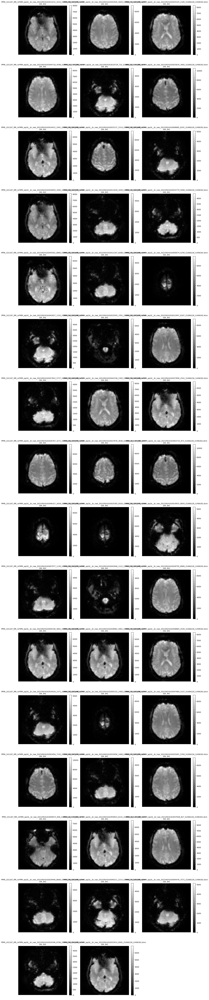


Processing completed successfully!


"if df is not None:\n    display_mri_images_3_per_row(df, slice_index='middle', figsize=(15, 15), cmap='gray') # Adjusted figsize for a 3x3 layout"

In [ ]:
# Example usage of the functions defined above
example_folder = "/content/fMRI"  # <== Change to your folder

# Process the MRI files and get the DataFrame
df = process_and_display_mri_folder(example_folder, max_images=47, save_df=False) # Adjusted max_images for 3x3 grid and set save_df to False

# Display the images in a 3x3 grid (using the existing function which defaults to 3 per row)
"""if df is not None:
    display_mri_images_3_per_row(df, slice_index='middle', figsize=(15, 15), cmap='gray') # Adjusted figsize for a 3x3 layout"""

Attempting to load DICOM file: Axial_PD_T2_TSE_01.dcm


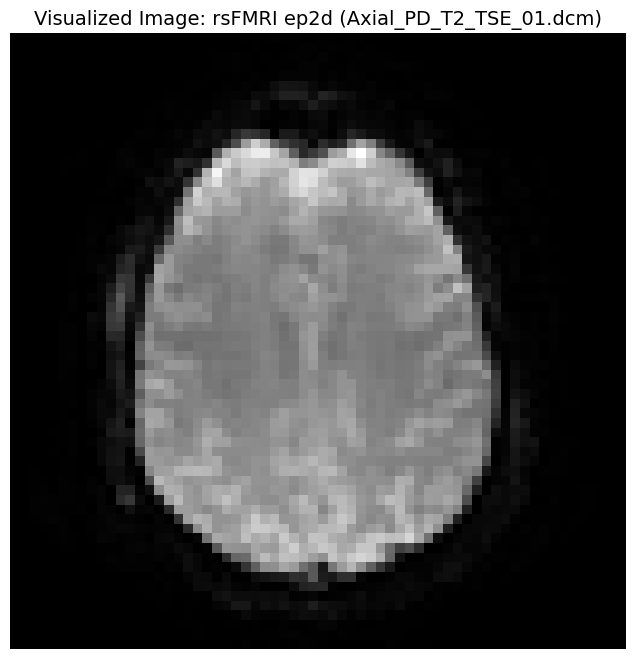

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pydicom

# --- CONFIGURATION ---
# This variable points to the DICOM file you uploaded
USER_IMAGE_ID = "/content/fMRI/PPMI_101187_MR_rsFMRI_ep2d__br_raw_20210924162959768_5309_S1066226_I1496302.dcm"
USER_IMAGE_FILENAME = "Axial_PD_T2_TSE_01.dcm"

if __name__ == "__main__":
    # 1. Installation check (run this first in Colab/Jupyter)
    # If this gives an error, you will need to run: !pip install pydicom

    try:
        print(f"Attempting to load DICOM file: {USER_IMAGE_FILENAME}")

        # 2. Load the DICOM file
        # pydicom.dcmread handles the loading of the .dcm file
        dicom_dataset = pydicom.dcmread(USER_IMAGE_ID)

        # 3. Extract the image data (Pixel Array)
        image_data = dicom_dataset.pixel_array

        # 4. Handle Multi-Dimensional Data (common in DTI sequences)
        # If the DICOM data is 3D or 4D, we take the first 2D slice for simple visualization
        if image_data.ndim > 2:
            print(f"INFO: Data has {image_data.ndim} dimensions. Displaying the first slice only.")
            # This takes the first 2D image plane (often the B0 or first diffusion direction)
            image_2d = image_data[..., 0]
        else:
            image_2d = image_data

        # 5. Visualization
        fig, ax = plt.subplots(1, 1, figsize=(8, 8))

        # Display the image using a grayscale colormap
        # DICOMs often benefit from 'gray' colormap
        ax.imshow(image_2d, cmap='gray')

        # Add context from the DICOM metadata
        series_desc = getattr(dicom_dataset, 'SeriesDescription', 'MRI Scan')
        ax.set_title(f"Visualized Image: {series_desc} ({USER_IMAGE_FILENAME})", fontsize=14)
        ax.axis('off') # Hide axes for a cleaner view

        # Show the plot
        plt.show()

    except FileNotFoundError:
        print(f"ERROR: Could not find the file {USER_IMAGE_FILENAME}. Please ensure it is uploaded correctly.")
    except ImportError:
        print("ERROR: 'pydicom' not found. Please install it using: !pip install pydicom")
    except Exception as e:
        print(f"An unexpected error occurred: {e}")
